<span style="color:green;font-weight:bold">Name : Rashmi Bhaskar 

<span style="color:green;font-weight:bold">Github Username : rashmibhaskar

<span style="color:green;font-weight:bold">USC ID : 4408460333

In [1]:
import pandas as pd 
import xgboost as xgb
from sklearn.tree import DecisionTreeClassifier
from sklearn import tree
import matplotlib.pyplot as plt
import numpy as np
from sklearn.tree import _tree
import math
import seaborn as sbn
from sklearn.linear_model import LinearRegression, Lasso, Ridge, RidgeCV, LassoCV
import xgboost as xgb
from sklearn import preprocessing
from sklearn.metrics import mean_squared_error, accuracy_score
from sklearn.decomposition import PCA
from sklearn.preprocessing import scale 
from sklearn import model_selection
from sklearn.model_selection import RepeatedKFold, GridSearchCV
from skmultilearn.problem_transform import LabelPowerset
import warnings
warnings.filterwarnings('ignore')

/Users/rashmibhaskar/opt/anaconda3/lib/python3.9/site-packages/xgboost/compat.py:36: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  from pandas import MultiIndex, Int64Index


#### 1. Decision Trees as Interpretable Models
#### (a) Download the Accute Inflamations data from https://archive.ics.uci.edu/ml/datasets/Acute+Inflammations.

In [2]:
data = pd.read_csv("../data/diagnosis.data", encoding='utf-16', delim_whitespace=True, names = ['Temperature', 'Nausea Occurrence', 'Lumbar pain', 'Urine pushing', 'Micturition pains', 'Burning', 'Inflammation of urinary bladder', 'Nephritis of renal pelvis origin'])
df = data.replace(to_replace=[",",'no', 'yes'], value=[".",0, 1], regex=True)

features = ['Temperature', 'Nausea Occurrence', 'Lumbar pain', 'Urine pushing', 'Micturition pains', 'Burning']
labels = ['Inflammation of urinary bladder', 'Nephritis of renal pelvis origin']
X = df.loc[:,features]
y = df.loc[:,labels]

display(X)
display(y)

,Temperature,Nausea Occurrence,Lumbar pain,Urine pushing,Micturition pains,Burning
0,35.5,0,1,0,0,0
1,35.9,0,0,1,1,1
2,35.9,0,1,0,0,0
3,36.0,0,0,1,1,1
4,36.0,0,1,0,0,0
...,...,...,...,...,...,...
115,41.4,0,1,1,0,1
116,41.5,0,0,0,0,0
117,41.5,1,1,0,1,0
118,41.5,0,1,1,0,1


,Inflammation of urinary bladder,Nephritis of renal pelvis origin
0,0,0
1,1,0
2,0,0
3,1,0
4,0,0
...,...,...
115,0,1
116,0,0
117,0,1
118,0,1


#### 1(b) Build a decision tree on the whole data set and plot it.


[Text(0.4, 0.9, 'Lumbar pain <= 0.5\ngini = 0.735\nsamples = 120\nvalue = [30, 40, 31, 19]\nclass = 1'),
 Text(0.2, 0.7, 'Urine pushing <= 0.5\ngini = 0.32\nsamples = 50\nvalue = [10, 40, 0, 0]\nclass = 1'),
 Text(0.1, 0.5, 'gini = 0.0\nsamples = 10\nvalue = [10, 0, 0, 0]\nclass = 0'),
 Text(0.3, 0.5, 'gini = 0.0\nsamples = 40\nvalue = [0, 40, 0, 0]\nclass = 1'),
 Text(0.6, 0.7, 'Temperature <= 37.95\ngini = 0.649\nsamples = 70\nvalue = [20, 0, 31, 19]\nclass = 2'),
 Text(0.5, 0.5, 'gini = 0.0\nsamples = 20\nvalue = [20, 0, 0, 0]\nclass = 0'),
 Text(0.7, 0.5, 'Nausea Occurrence <= 0.5\ngini = 0.471\nsamples = 50\nvalue = [0, 0, 31, 19]\nclass = 2'),
 Text(0.6, 0.3, 'gini = 0.0\nsamples = 21\nvalue = [0, 0, 21, 0]\nclass = 2'),
 Text(0.8, 0.3, 'Urine pushing <= 0.5\ngini = 0.452\nsamples = 29\nvalue = [0, 0, 10, 19]\nclass = 3'),
 Text(0.7, 0.1, 'gini = 0.0\nsamples = 10\nvalue = [0, 0, 10, 0]\nclass = 2'),
 Text(0.9, 0.1, 'gini = 0.0\nsamples = 19\nvalue = [0, 0, 0, 19]\nclass = 3')]

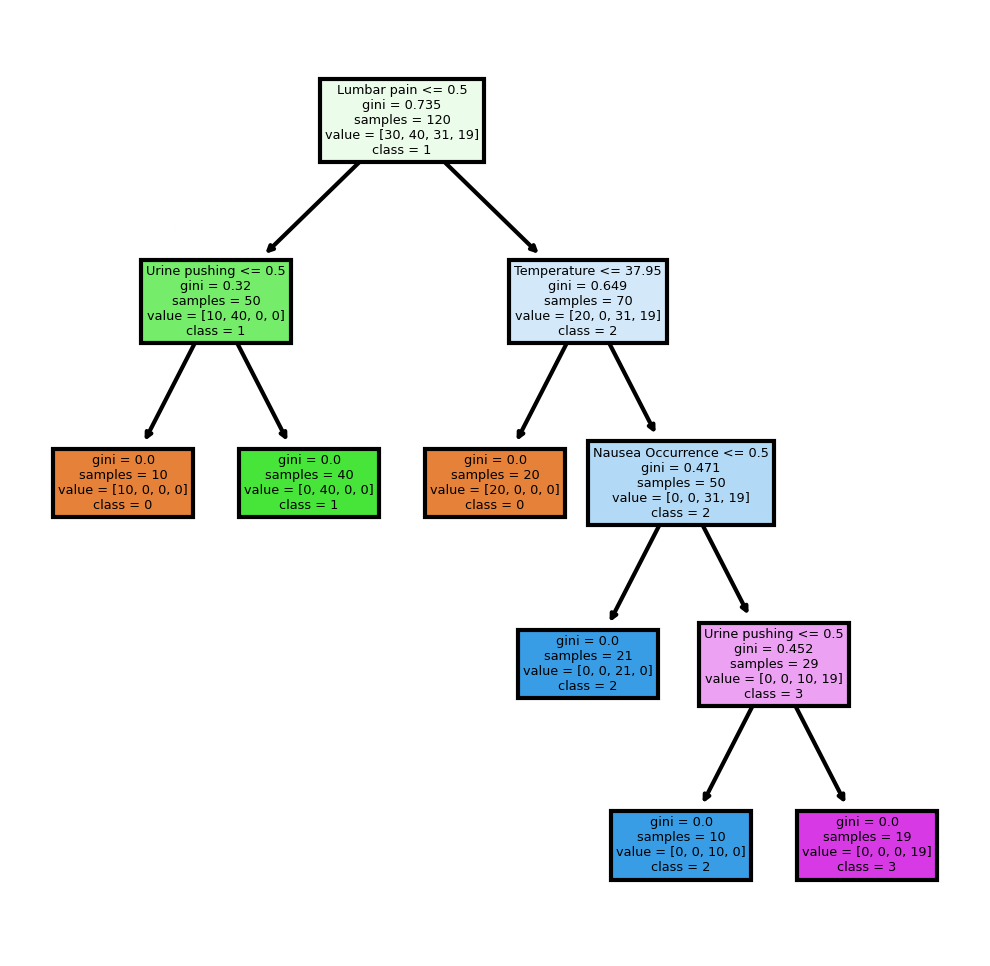

In [3]:
lb = LabelPowerset()
y_lb = lb.transform(y)
clf = DecisionTreeClassifier(random_state=42)
clf = clf.fit(X, y_lb)
fig, axes = plt.subplots(nrows = 1,ncols = 1,figsize = (4,4), dpi=300)
tree.plot_tree(clf, feature_names = features, class_names= ['0','1','2','3'], filled = True)

#### 1(c) Convert the decision rules into a set of IF-THEN rules.

In [4]:
def tree_to_pseudo(tree, feature_names):
	"""
	Outputs a decision tree model as if/then pseudocode
	
	Parameters:
	-----------
	tree: decision tree model
		The decision tree to represent as pseudocode
	feature_names: list
		The feature names of the dataset used for building the decision tree
	"""

	left = tree.tree_.children_left
	right = tree.tree_.children_right
	threshold = tree.tree_.threshold
	features = [feature_names[i] for i in tree.tree_.feature]
	value = tree.tree_.value

	def recurse(left, right, threshold, features, node, depth=0):
		indent = "  " * depth
		if (threshold[node] != -2):
			print(indent,"if ( " + features[node] + " <= " + str(threshold[node]) + " ) {")
			if left[node] != -1:
				recurse (left, right, threshold, features, left[node], depth+1)
				print(indent,"} else {")
				if right[node] != -1:
					recurse (left, right, threshold, features, right[node], depth+1)
				print(indent,"}")
		else:
			print(indent,"return " + str(value[node]))

	recurse(left, right, threshold, features, 0)

tree_to_pseudo(clf, features)

 if ( Lumbar pain <= 0.5 ) {
   if ( Urine pushing <= 0.5 ) {
     return [[10.  0.  0.  0.]]
   } else {
     return [[ 0. 40.  0.  0.]]
   }
 } else {
   if ( Temperature <= 37.95000076293945 ) {
     return [[20.  0.  0.  0.]]
   } else {
     if ( Nausea Occurrence <= 0.5 ) {
       return [[ 0.  0. 21.  0.]]
     } else {
       if ( Urine pushing <= 0.5 ) {
         return [[ 0.  0. 10.  0.]]
       } else {
         return [[ 0.  0.  0. 19.]]
       }
     }
   }
 }


In [5]:
#more human readable IF-THEN rules
def get_rules(tree, feature_names, class_names):
    tree_ = tree.tree_
    feature_name = [
        feature_names[i] if i != _tree.TREE_UNDEFINED else "undefined!"
        for i in tree_.feature
    ]

    paths = []
    path = []
    
    def recurse(node, path, paths):
        
        if tree_.feature[node] != _tree.TREE_UNDEFINED:
            name = feature_name[node]
            threshold = tree_.threshold[node]
            p1, p2 = list(path), list(path)
            p1 += [f"({name} <= {np.round(threshold, 3)})"]
            recurse(tree_.children_left[node], p1, paths)
            p2 += [f"({name} > {np.round(threshold, 3)})"]
            recurse(tree_.children_right[node], p2, paths)
        else:
            path += [(tree_.value[node], tree_.n_node_samples[node])]
            paths += [path]
            
    recurse(0, path, paths)

    # sort by samples count
    samples_count = [p[-1][1] for p in paths]
    ii = list(np.argsort(samples_count))
    paths = [paths[i] for i in reversed(ii)]
    
    rules = []
    for path in paths:
        rule = "if "
        
        for p in path[:-1]:
            if rule != "if ":
                rule += " and "
            rule += str(p)
        rule += " then "
        if class_names is None:
            rule += "response: "+str(np.round(path[-1][0][0][0],3))
        else:
            classes = path[-1][0][0]
            l = np.argmax(classes)
            rule += f"class: {class_names[l]} (proba: {np.round(100.0*classes[l]/np.sum(classes),2)}%)"
        rule += f" | based on {path[-1][1]:,} samples"
        rules += [rule]
        
    return rules

print("MORE HUMAN READABLE IF-THEN RULES")
rules = get_rules(clf, features, ['0','1','2','3'])
for r in rules:
    print(r)

MORE HUMAN READABLE IF-THEN RULES
if (Lumbar pain <= 0.5) and (Urine pushing > 0.5) then class: 1 (proba: 100.0%) | based on 40 samples
if (Lumbar pain > 0.5) and (Temperature > 37.95) and (Nausea Occurrence <= 0.5) then class: 2 (proba: 100.0%) | based on 21 samples
if (Lumbar pain > 0.5) and (Temperature <= 37.95) then class: 0 (proba: 100.0%) | based on 20 samples
if (Lumbar pain > 0.5) and (Temperature > 37.95) and (Nausea Occurrence > 0.5) and (Urine pushing > 0.5) then class: 3 (proba: 100.0%) | based on 19 samples
if (Lumbar pain > 0.5) and (Temperature > 37.95) and (Nausea Occurrence > 0.5) and (Urine pushing <= 0.5) then class: 2 (proba: 100.0%) | based on 10 samples
if (Lumbar pain <= 0.5) and (Urine pushing <= 0.5) then class: 0 (proba: 100.0%) | based on 10 samples


#### 1(d) Use cost-complexity pruning to find a minimal decision tree and a set of decision rules with high interpretability.

Best alpha is:  0.0
Best accuracy is:  1.0
IF-THEN rules with high interpretabiblity: 
if (Lumbar pain <= 0.5) and (Urine pushing > 0.5) then class: 1 (proba: 100.0%) | based on 40 samples
if (Lumbar pain > 0.5) and (Temperature > 37.95) and (Nausea Occurrence <= 0.5) then class: 2 (proba: 100.0%) | based on 21 samples
if (Lumbar pain > 0.5) and (Temperature <= 37.95) then class: 0 (proba: 100.0%) | based on 20 samples
if (Lumbar pain > 0.5) and (Temperature > 37.95) and (Nausea Occurrence > 0.5) and (Urine pushing > 0.5) then class: 3 (proba: 100.0%) | based on 19 samples
if (Lumbar pain > 0.5) and (Temperature > 37.95) and (Nausea Occurrence > 0.5) and (Urine pushing <= 0.5) then class: 2 (proba: 100.0%) | based on 10 samples
if (Lumbar pain <= 0.5) and (Urine pushing <= 0.5) then class: 0 (proba: 100.0%) | based on 10 samples


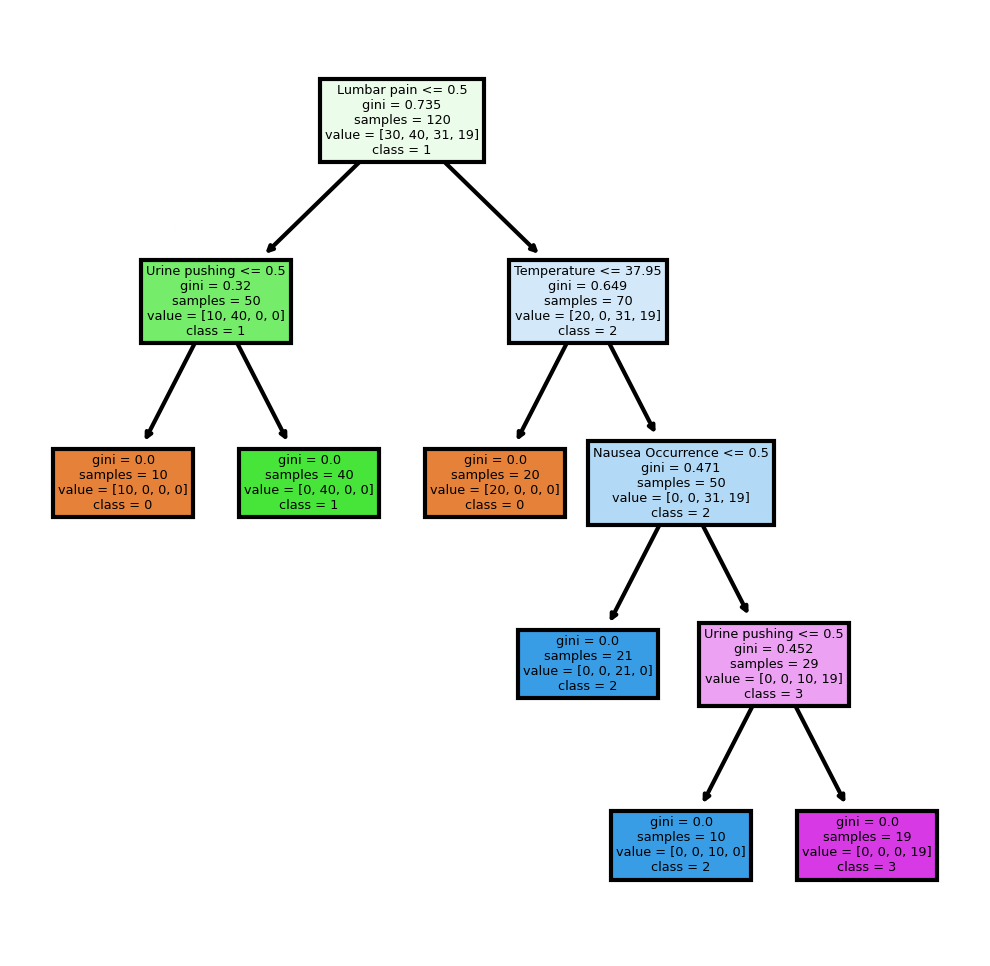

In [6]:
path = clf.cost_complexity_pruning_path(X,y_lb)

tree_model_params = {'ccp_alpha': path['ccp_alphas']}
tree_cv = GridSearchCV(clf, tree_model_params, cv=5)
tree_cv = tree_cv.fit(X,y_lb)

best_alpha_dt = tree_cv.best_params_['ccp_alpha']
best_tree_a = DecisionTreeClassifier(ccp_alpha=best_alpha_dt,random_state=42)
best_tree_a.fit(X,y_lb)
best_y_pred = best_tree_a.predict(X)
best_acc = accuracy_score(y_lb,best_y_pred)

print("Best alpha is: ",best_alpha_dt)
print("Best accuracy is: ",best_acc)

fig, axes = plt.subplots(nrows = 1,ncols = 1,figsize = (4,4), dpi=300)
tree.plot_tree(best_tree_a, feature_names = features, class_names= ['0','1','2','3'], filled = True)

print("IF-THEN rules with high interpretabiblity: ")
rules = get_rules(best_tree_a, features, ['0','1','2','3'])
for r in rules:
    print(r)

#### 2. The LASSO and Boosting for Regression

#### (a) Download the Communities and Crime data from https://archive.ics.uci.edu/ml/datasets/Communities+and+Crime. Use the first 1495 rows of data as the training set and the rest as the test set.

#### (b) The data set has missing values. Use a data imputation technique to deal with the missing values in the data set. The data description mentions some features are nonpredictive. Ignore those features.

In [7]:
line_map = {}
with open('../data/community_variables.txt') as file:
    lines = file.readlines()
    lines = [line.rstrip() for line in lines]
    for line in lines:
        l = line.split(":")
        line_map[l[0]] = l[1].strip()
comm_col = list(line_map.keys())

comm_data = pd.read_csv("../data/communities.data", delimiter=",", names=comm_col, na_values=['?'])
comm_data = comm_data.drop(['state','county','community','communityname','fold'], axis = 1)
comm_data = comm_data.fillna(comm_data.mean())

comm_features = comm_data.columns.values.tolist()[:-1]
comm_label = [comm_data.columns.values.tolist()[-1]]

Train = comm_data.iloc[:1495,:]
Test = comm_data.iloc[1495:,:]

X_train = Train.loc[:,comm_features]
y_train = Train.loc[:,comm_label]
X_test = Test.loc[:,comm_features]
y_test = Test.loc[:,comm_label]
display(X_train)
display(X_test)
display(y_train)
display(y_test)



,population,householdsize,racepctblack,racePctWhite,racePctAsian,racePctHisp,agePct12t21,agePct12t29,agePct16t24,agePct65up,...,PolicAveOTWorked,LandArea,PopDens,PctUsePubTrans,PolicCars,PolicOperBudg,LemasPctPolicOnPatr,LemasGangUnitDeploy,LemasPctOfficDrugUn,PolicBudgPerPop
0,0.19,0.33,0.02,0.90,0.12,0.17,0.34,0.47,0.29,0.32,...,0.290000,0.12,0.26,0.20,0.060000,0.040000,0.900000,0.500000,0.32,0.140000
1,0.00,0.16,0.12,0.74,0.45,0.07,0.26,0.59,0.35,0.27,...,0.305987,0.02,0.12,0.45,0.163103,0.076708,0.698589,0.440439,0.00,0.195078
2,0.00,0.42,0.49,0.56,0.17,0.04,0.39,0.47,0.28,0.32,...,0.305987,0.01,0.21,0.02,0.163103,0.076708,0.698589,0.440439,0.00,0.195078
3,0.04,0.77,1.00,0.08,0.12,0.10,0.51,0.50,0.34,0.21,...,0.305987,0.02,0.39,0.28,0.163103,0.076708,0.698589,0.440439,0.00,0.195078
4,0.01,0.55,0.02,0.95,0.09,0.05,0.38,0.38,0.23,0.36,...,0.305987,0.04,0.09,0.02,0.163103,0.076708,0.698589,0.440439,0.00,0.195078
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1490,0.00,0.59,0.01,0.69,1.00,0.07,0.41,0.28,0.23,0.57,...,0.305987,0.02,0.14,0.22,0.163103,0.076708,0.698589,0.440439,0.00,0.195078
1491,0.16,0.62,0.03,0.74,0.48,0.42,0.44,0.57,0.40,0.25,...,0.380000,0.07,0.40,0.14,0.070000,0.050000,0.850000,0.500000,0.61,0.190000
1492,0.01,0.36,0.95,0.24,0.03,0.01,0.44,0.42,0.27,0.63,...,0.305987,0.03,0.12,0.01,0.163103,0.076708,0.698589,0.440439,0.00,0.195078
1493,0.06,0.53,0.01,0.98,0.05,0.01,0.40,0.40,0.24,0.29,...,0.305987,0.08,0.15,0.02,0.163103,0.076708,0.698589,0.440439,0.00,0.195078


,population,householdsize,racepctblack,racePctWhite,racePctAsian,racePctHisp,agePct12t21,agePct12t29,agePct16t24,agePct65up,...,PolicAveOTWorked,LandArea,PopDens,PctUsePubTrans,PolicCars,PolicOperBudg,LemasPctPolicOnPatr,LemasGangUnitDeploy,LemasPctOfficDrugUn,PolicBudgPerPop
1495,0.00,0.20,0.03,0.91,0.23,0.05,0.15,0.19,0.09,0.42,...,0.305987,0.01,0.23,0.73,0.163103,0.076708,0.698589,0.440439,0.00,0.195078
1496,0.00,0.55,0.13,0.78,0.15,0.36,0.48,0.53,0.30,0.10,...,0.305987,0.01,0.18,0.02,0.163103,0.076708,0.698589,0.440439,0.00,0.195078
1497,0.00,0.52,0.04,0.59,0.05,0.62,0.84,0.78,0.75,0.43,...,0.305987,0.01,0.18,0.00,0.163103,0.076708,0.698589,0.440439,0.00,0.195078
1498,0.04,0.51,0.07,0.92,0.09,0.03,0.38,0.47,0.27,0.35,...,0.305987,0.06,0.13,0.16,0.163103,0.076708,0.698589,0.440439,0.00,0.195078
1499,0.03,0.59,0.20,0.75,0.19,0.10,0.38,0.62,0.35,0.11,...,0.305987,0.03,0.23,0.06,0.163103,0.076708,0.698589,0.440439,0.00,0.195078
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1989,0.01,0.40,0.10,0.87,0.12,0.16,0.43,0.51,0.35,0.30,...,0.305987,0.01,0.28,0.05,0.163103,0.076708,0.698589,0.440439,0.00,0.195078
1990,0.05,0.96,0.46,0.28,0.83,0.32,0.69,0.86,0.73,0.14,...,0.305987,0.02,0.37,0.20,0.163103,0.076708,0.698589,0.440439,0.00,0.195078
1991,0.16,0.37,0.25,0.69,0.04,0.25,0.35,0.50,0.31,0.54,...,0.250000,0.08,0.32,0.18,0.080000,0.060000,0.780000,0.000000,0.91,0.280000
1992,0.08,0.51,0.06,0.87,0.22,0.10,0.58,0.74,0.63,0.41,...,0.190000,0.03,0.38,0.33,0.020000,0.020000,0.790000,0.000000,0.22,0.180000


,ViolentCrimesPerPop
0,0.20
1,0.67
2,0.43
3,0.12
4,0.03
...,...
1490,0.03
1491,0.20
1492,0.30
1493,0.03


,ViolentCrimesPerPop
1495,0.12
1496,0.11
1497,0.12
1498,0.06
1499,0.12
...,...
1989,0.09
1990,0.45
1991,0.23
1992,0.19


#### 2(c)Plot a correlation matrix for the features in the data set.

In [8]:
corr = comm_data.loc[:,comm_features].corr()
corr.style.background_gradient(cmap='PRGn')

#### 2(d)Calculate the Coefficient of Variation CV for each feature, where CV = s/m, in which s is sample standard deviation and m is sample mean.

In [9]:
cv_dict={}
for f in comm_features:
    cv_dict[f] = comm_data[f].std()/comm_data[f].mean()

cv = pd.DataFrame(cv_dict.items(),columns=['Feature','Coefficient of Variation'])
display(cv)

,Feature,Coefficient of Variation
0,population,2.203503
1,householdsize,0.353298
2,racepctblack,1.410920
3,racePctWhite,0.323782
4,racePctAsian,1.359162
...,...,...
117,PolicOperBudg,0.730107
118,LemasPctPolicOnPatr,0.122331
119,LemasGangUnitDeploy,0.368040
120,LemasPctOfficDrugUn,2.555266


#### 2e)Pick √128 features with highest CV, and make scatter plots and box plots for them. Can you draw conclusions about significance of those features, just by the scatter plots?

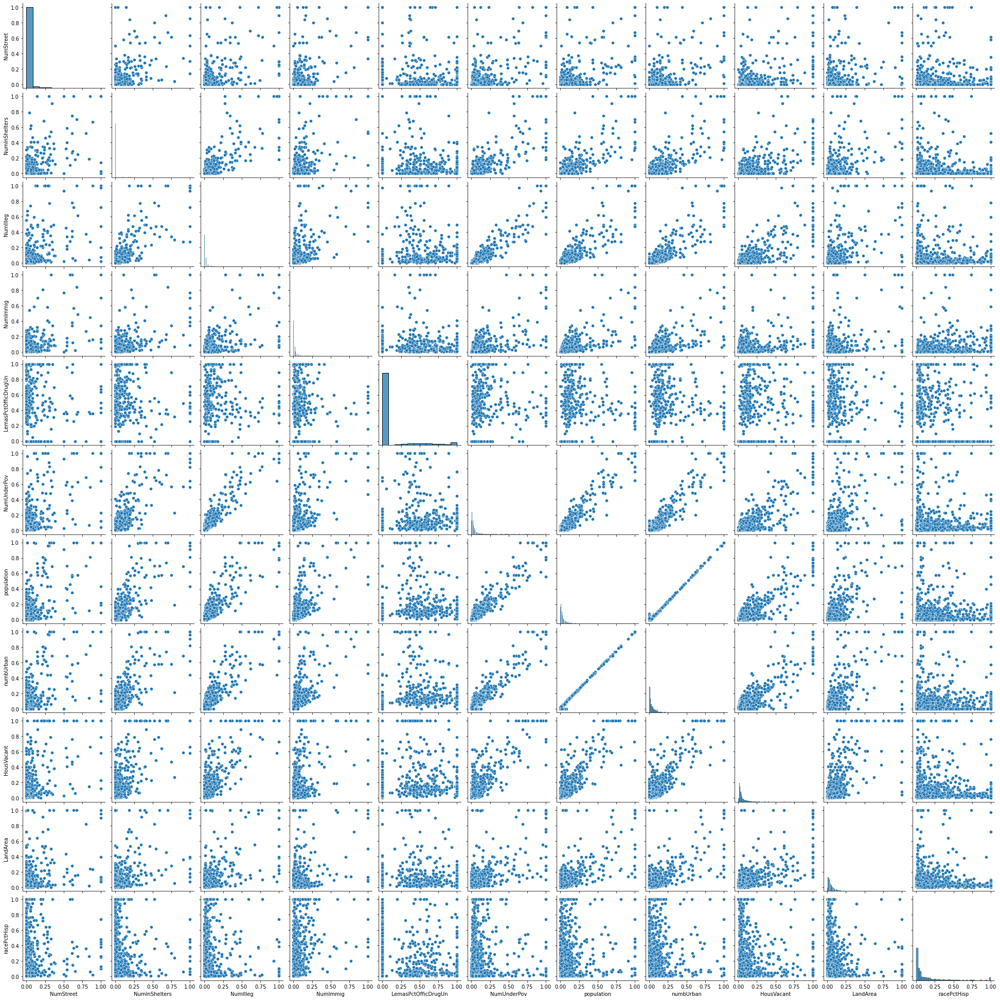

In [10]:
sorted_cv = cv.sort_values(by='Coefficient of Variation', ascending=False)
top_value = math.floor(math.sqrt(128))

top_cv = sorted_cv.iloc[:top_value,:]
top_features = top_cv['Feature']

sbn.pairplot(data=comm_data[top_features])

## Findings:

#### From the above scatter plot we can see strong positive linear correlation between population and numbUrban features. 

#### For some plots where data points are running from bottom left to top right we might consider some positive linear relation.

#### For the rest, we cannot make conclusions on their linear relations since they are all scattered across.

<AxesSubplot:>

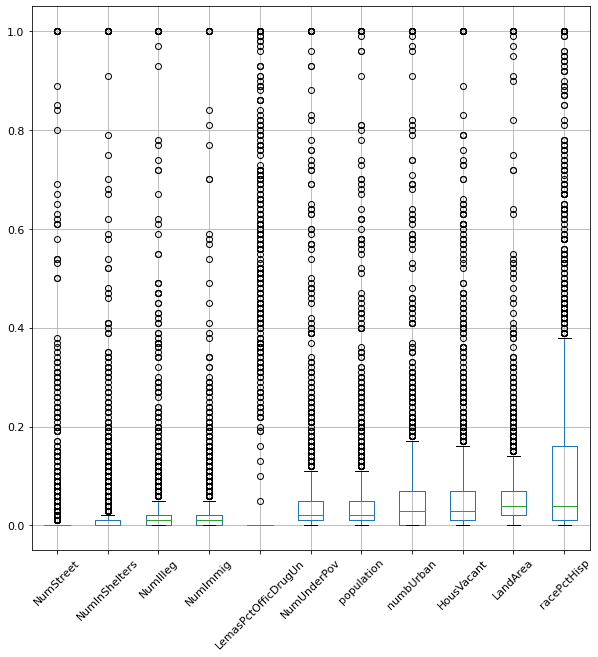

In [11]:
comm_data[top_features].boxplot(rot=45, fontsize=11, figsize=(10, 10))

#### 2(f)Fit a linear model using least squares to the training set and report the test error.

In [12]:
linear_model = LinearRegression().fit(X_train,y_train)
y_pred_linear = linear_model.predict(X_test)
mse_linear = mean_squared_error(y_test, y_pred_linear)
print('Test error for Linear Model: ', mse_linear)

Test error for Linear Model:  0.7897255274257218


#### 2(g) Fit a ridge regression model on the training set, with λ chosen by cross-validation.Report the test error obtained.

In [13]:
ridge_model_cv = RidgeCV(alphas= [1e-3, 1e-2, 1e-1, 1, 1e+1, 1e+2, 1e+3, 1e+4], cv=5).fit(X_train,y_train)
best_alpha_ridge = ridge_model_cv.alpha_
print('Best Alpha for Ridge Regression: ', best_alpha_ridge)

ridge_model = Ridge(alpha=best_alpha_ridge).fit(X_train,y_train)
y_pred_ridge = ridge_model.predict(X_test)
mse_ridge = mean_squared_error(y_test, y_pred_ridge)  
print('Test error for Ridge Regression: ', mse_ridge)

Best Alpha for Ridge Regression:  1.0
Test error for Ridge Regression:  0.017737081104303686


#### 2(h) Fit a LASSO model on the training set, with λ chosen by cross-validation. Report the test error obtained, along with a list of the variables selected by the model. Repeat with standardized 4 features. Report the test error for both cases and compare them.

In [14]:
lasso_model_cv = LassoCV(alphas= [1e-3, 1e-2, 1e-1, 1, 1e+1, 1e+2, 1e+3, 1e+4], cv=5).fit(X_train,y_train.values.ravel())
best_alpha_lasso = lasso_model_cv.alpha_
print('Best Alpha for Lasso Regression: ', best_alpha_lasso)

lasso_model = Lasso(alpha=best_alpha_lasso).fit(X_train,y_train)
y_pred_lasso = lasso_model.predict(X_test)
mse_lasso = mean_squared_error(y_test, y_pred_lasso)  
print('Test error for Lasso Regression: ', mse_lasso)

lasso_coefficients = lasso_model.coef_
selected_features_lasso = []
for idx,coef in enumerate(lasso_coefficients):
    if(coef!=0):
        selected_features_lasso.append([comm_features[idx],coef]) 

display(pd.DataFrame(selected_features_lasso,columns=['Feature', 'Co-Efficient']))

scaler = preprocessing.StandardScaler().fit(X_train)
X_train_scaled = scaler.transform(X_train)
X_test_scaled = scaler.transform(X_test)

lasso_model_scaled_cv = LassoCV(alphas= [1e-3, 1e-2, 1e-1, 1, 1e+1, 1e+2, 1e+3, 1e+4], cv=5).fit(X_train_scaled,y_train.values.ravel())
best_alpha_lasso_ = lasso_model_scaled_cv.alpha_ 
print('Best Alpha for Lasso Regression(standardized): ', best_alpha_lasso_)

lasso_model_scaled = Lasso(alpha=best_alpha_lasso).fit(X_train_scaled,y_train.values.ravel())
y_pred_lasso_scaled = lasso_model_scaled.predict(X_test_scaled)
mse_lasso_scaled = mean_squared_error(y_test, y_pred_lasso_scaled)  
print('Test error for Lasso Regression(standardized): ', mse_lasso_scaled)

lasso_coefficients_ = lasso_model_scaled.coef_
selected_features_lasso_ = []
for idx,coef in enumerate(lasso_coefficients_):
    if(coef!=0):
        selected_features_lasso_.append([comm_features[idx],coef]) 

display(pd.DataFrame(selected_features_lasso_,columns=['Feature', 'Co-Efficient']))



Best Alpha for Lasso Regression:  0.001
Test error for Lasso Regression:  0.01754528781156862


,Feature,Co-Efficient
0,racepctblack,0.211027
1,racePctWhite,-0.011076
2,agePct12t29,-0.005967
3,pctUrban,0.038246
4,pctWPubAsst,0.029043
5,AsianPerCap,0.010083
6,MalePctDivorce,0.145153
7,PctKids2Par,-0.215357
8,PctYoungKids2Par,-0.006970
9,PctWorkMom,-0.049358


Best Alpha for Lasso Regression(standardized):  0.001
Test error for Lasso Regression(standardized):  0.017762886468429207


,Feature,Co-Efficient
0,racepctblack,0.066826
1,agePct12t21,0.005221
2,agePct12t29,-0.028515
3,pctUrban,0.015671
4,pctWWage,-0.008756
...,...,...
63,PopDens,0.002498
64,PctUsePubTrans,-0.007064
65,PolicCars,0.002402
66,LemasPctPolicOnPatr,0.002286


#### On comparing the test errors for Lasso on basic features and the standardized features, the Lasso model with raw features performs better thus giving top 23 best features with alpha value 0.001. Since we are working on dataset where the raw features seem to be normalized already, it makes more sense when model with the raw features performs better. 

#### Also, I have used alpha values ranging from 1e-3 to 1e+4 since theses set of values do not give any convergence issue during cross validation.

#### 2 (i) Fit a PCR model on the training set, with M (the number of principal components) chosen by cross-validation. Report the test error obtained.

Best M:  96
Test Error for Principal Component Regression:  0.018481058259821263


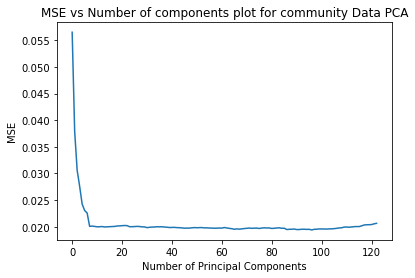

In [17]:
pca = PCA()
X_train_pca = pca.fit_transform(X_train)

regr = LinearRegression()
mse = []

score = -1*model_selection.cross_val_score(regr,
           np.ones((len(X_train_pca),1)),y_train , cv=5,
           scoring='neg_mean_squared_error').mean()    
mse.append(score)

for i in range(1, len(comm_features)+1):
    score = -1*model_selection.cross_val_score(regr,
               X_train_pca[:,:i], y_train, cv=5, scoring='neg_mean_squared_error').mean()
    mse.append(score)
       
plt.plot(mse)
plt.xlabel('Number of Principal Components')
plt.ylabel('MSE')
plt.title('MSE vs Number of components plot for community Data PCA')

best_m = mse.index(min(mse))
pca_final = PCA(n_components=best_m)
pca_final = pca_final.fit(X_train)
X_train_pca = pca_final.transform(X_train)
X_test_pca = pca_final.transform(X_test)

pcr_model = LinearRegression()
pcr_model = pcr_model.fit(X_train_pca, y_train)

y_pred_pcr = pcr_model.predict(X_test_pca)

mse_pcr = mean_squared_error(y_test, y_pred_pcr)
print("Best M: ",best_m) 
print('Test Error for Principal Component Regression: ', mse_pcr)


#### 2(j) In this section, we would like to fit a boosting tree to the data. As in classification trees, one can use any type of regression at each node to build a multivariate regression tree. Because the number of variables is large in this problem, one can use L1-penalized regression at each node. Such a tree is calledL 1 penalized gradient boosting tree. You can use XGBoost to fit the model tree. Determine α (the regularization term) using cross-validation.

In [18]:
xgb_model = xgb.XGBRegressor(objective='reg:squarederror')
xgb_params = {'reg_alpha': [1e-3, 1e-2, 1e-1, 1, 1e+1, 1e+2, 1e+3, 1e+4]}
xgb_model_cv = GridSearchCV(xgb_model, xgb_params, cv=5)
xgb_model_cv = xgb_model_cv.fit(X_train, y_train)

best_alpha_xgb = xgb_model_cv.best_params_['reg_alpha']
xgb_model_final = xgb.XGBRegressor(objective='reg:squarederror', reg_alpha=best_alpha_xgb)
xgb_model_final = xgb_model_final.fit(X_train, y_train)

y_pred_xgb = xgb_model_final.predict(X_test)
mse_xgb = mean_squared_error(y_test, y_pred_xgb)

print('Best alpha for XGBoost is: ', best_alpha_xgb)
print('Test Error for XGBoost is: ', mse_xgb)

Best alpha for XGBoost is:  1
Test Error for XGBoost is:  0.017528005381199942


#### References/Links

[1] - https://mljar.com/blog/extract-rules-decision-tree/

[2] - https://towardsdatascience.com/visualizing-decision-trees-with-python-scikit-learn-graphviz-matplotlib-1c50b4aa68dc

[3] - https://towardsdatascience.com/understanding-decision-trees-for-classification-python-9663d683c952

[4] - https://www.analyticsvidhya.com/blog/2020/10/cost-complexity-pruning-decision-trees/

[5] - https://stackoverflow.com/questions/29432629/plot-correlation-matrix-using-pandas

[6] - https://www.analyticsvidhya.com/blog/2021/06/defining-analysing-and-implementing-imputation-techniques/

[7] - https://blog.jovian.ai/imputation-of-missing-numeric-data-for-data-science-in-python-126f7e946917#f203

[8] - https://scikit-learn.org/stable/auto_examples/tree/plot_cost_complexity_pruning.html

[9] - https://stackoverflow.com/questions/63037248/is-it-correct-to-use-a-single-standardscaler-before-splitting-data

[10] - https://chrisalbon.com/code/machine_learning/linear_regression/selecting_best_alpha_value_in_ridge_regression/

[11] - https://www.statology.org/principal-components-regression-in-python/

[12] - https://towardsdatascience.com/getting-started-with-xgboost-in-scikit-learn-f69f5f470a97

[13] - https://towardsdatascience.com/principal-component-analysis-pca-with-scikit-learn-1e84a0c731b0

[14] - https://www.kdnuggets.com/2017/05/simplifying-decision-tree-interpretation-decision-rules-python.html

[15] - https://www.analyticsvidhya.com/blog/2017/08/introduction-to-multi-label-classification/